# Exploratory Data Analysis

In [1]:
%matplotlib inline

# Filter warnings
import warnings
warnings.filterwarnings("ignore")

# Data manipulation
import pandas as pd
import numpy as np

# Data visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Set font scale and style
plt.rcParams.update({'font.size': 15})

# Load  data

In [2]:
df = pd.read_csv('../data/clean_data.csv') 
print('Data size',df.shape)
df.head()

Data size (89990, 19)


,collision_id,location,x,y,longitude,latitude,environment,light,surface_condition,traffic_control,traffic_control_condition,class,impact_type,no_of_pedestrians,fid,c_year,c_month,c_day,c_hour
0,13-704,ROBERTSON RD btwn MOODIE DR & VANIER RD,357144.87500,5020503.5,-75.832298,45.322533,01 - Clear,07 - Dark,01 - Dry,10 - No control,NaN,Non-fatal injury,02 - Angle,0.0,1,2013,January,Friday,23
1,13-806,FALLOWFIELD RD btwn EAGLESON RD & RICHMOND RD,356860.18750,5013034.5,-75.836708,45.255344,05 - Drifting Snow,01 - Daylight,06 - Ice,10 - No control,NaN,P.D. only,01 - Approaching,0.0,2,2013,January,Sunday,18
2,13-101,FIFTH AVE @ RUPERT ST,368589.71875,5029516.5,-75.685158,45.402679,03 - Snow,01 - Daylight,06 - Ice,02 - Stop sign,01 - Functioning,P.D. only,02 - Angle,0.0,3,2013,January,Thursday,21
3,13-502,BIRCH AVE @ FARNHAM CRES,370292.90625,5035187.0,-75.662651,45.453541,01 - Clear,01 - Daylight,02 - Wet,02 - Stop sign,01 - Functioning,P.D. only,02 - Angle,0.0,4,2013,January,Saturday,21
4,13-503,ALESTHER ST btwn QUEEN MARY ST & PRINCE ALBERT ST,372133.18750,5032130.5,-75.639542,45.425865,02 - Rain,07 - Dark,02 - Wet,10 - No control,NaN,P.D. only,06 - SMV unattended vehicle,0.0,5,2013,January,Friday,4


# Data types

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 89990 entries, 0 to 89989
Data columns (total 19 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   collision_id               89990 non-null  object 
 1   location                   89990 non-null  object 
 2   x                          89990 non-null  float64
 3   y                          89990 non-null  float64
 4   longitude                  89990 non-null  float64
 5   latitude                   89990 non-null  float64
 6   environment                89989 non-null  object 
 7   light                      89990 non-null  object 
 8   surface_condition          89990 non-null  object 
 9   traffic_control            89954 non-null  object 
 10  traffic_control_condition  46084 non-null  object 
 11  class                      89990 non-null  object 
 12  impact_type                89990 non-null  object 
 13  no_of_pedestrians          89990 non-null  flo

# Class distribution

In [4]:
label_pct = df['class'].value_counts(normalize = True)*100
label_ct =  df['class'].value_counts()
pd.DataFrame({'labels': label_pct.index, 'count': label_ct.values, 'percentage': label_pct.values})

,labels,count,percentage
0,P.D. only,73454,81.624625
1,Non-fatal injury,16392,18.215357
2,Fatal injury,144,0.160018


# Descriptive statistics

In [5]:
df.drop('class', axis =1).describe()

,x,y,longitude,latitude,no_of_pedestrians,fid,c_year,c_hour
count,89990.000000,8.999000e+04,89990.000000,89990.000000,89990.000000,89990.000000,89990.000000,89990.000000
mean,367055.621853,5.026107e+06,-75.705113,45.372079,0.020147,7517.577598,2015.865885,13.127514
std,9521.279635,7.458892e+03,0.121997,0.066757,0.147675,4361.267168,2.146871,6.846528
min,317371.280600,4.981006e+06,-76.339368,44.967049,0.000000,1.000000,2013.000000,0.000000
25%,363300.777912,5.022055e+06,-75.753180,45.335791,0.000000,3750.000000,2014.000000,8.000000
50%,367821.375000,5.027410e+06,-75.694885,45.383797,0.000000,7500.000000,2015.000000,14.000000
75%,371895.140625,5.031361e+06,-75.643129,45.419304,0.000000,11249.000000,2018.000000,19.000000
max,401809.000000,5.043440e+06,-75.261742,46.123177,4.000000,16399.000000,2019.000000,23.000000


# Correlation matrix
The variables x and y measure the same quantity as longitude and latitude

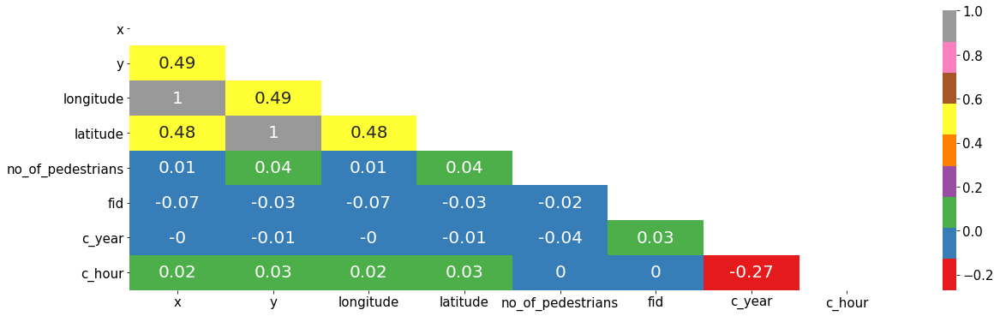

In [6]:
fig, ax = plt.subplots(figsize=(20,6))

# Correlation matrix
corr_matrix = df.drop('class', axis =1).corr()

# Plot
mask = np.zeros_like(corr_matrix, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(round(corr_matrix, 2), annot=True, annot_kws={"size": 20},mask = mask, 
            cmap = plt.get_cmap("Set1"),ax = ax)
plt.show()

# Histogram distribution

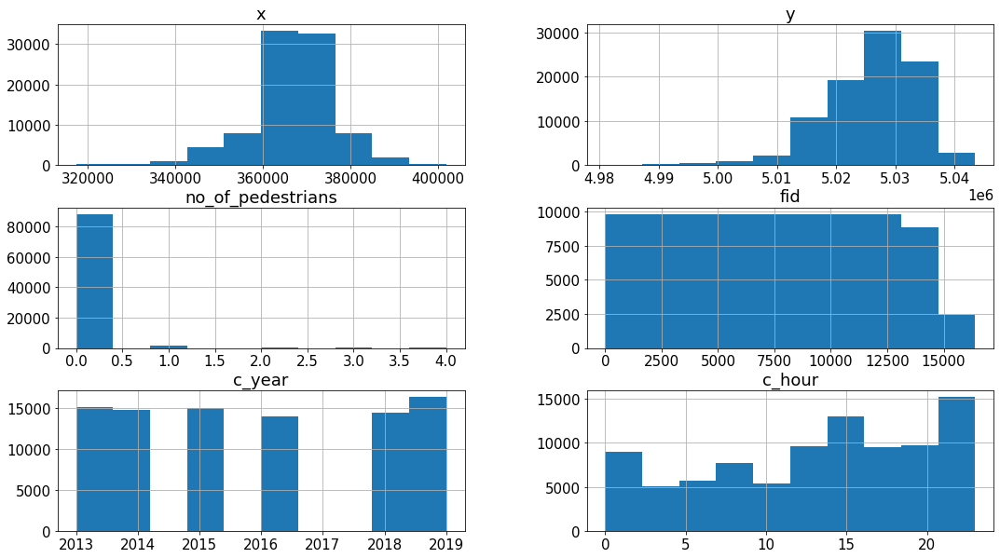

In [11]:
 df.drop(['longitude','latitude','class'], axis =1).hist(figsize = (18,10))
 plt.show()

# Collision Map by Latitude and Longitude

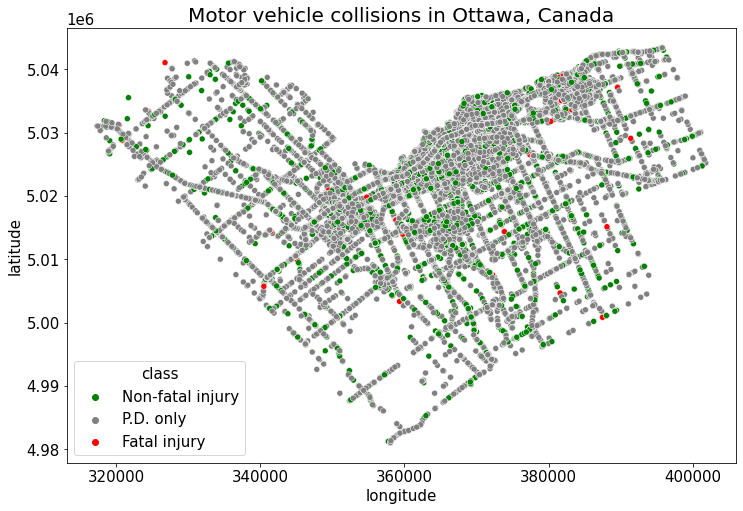

In [12]:
# Plot
plt.figure(figsize = (12,8))
sns.scatterplot(data = df, x = 'x', y = 'y', hue = 'class', palette= ['g','gray', 'r'])
plt.title('Motor vehicle collisions in Ottawa, Canada', fontsize = 20)
plt.xlabel('longitude')
plt.ylabel('latitude')
plt.savefig('../image/map.png')

#  Fatality rate per month
- Fatal accidents are mostly likely in July, i.e. during the summer season. They also occur mostly on Sundays

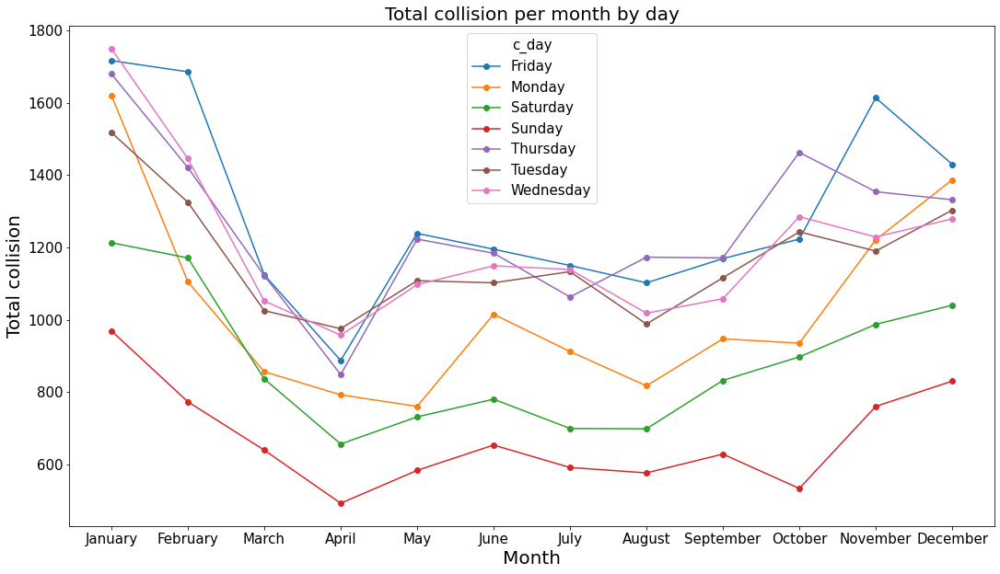

<Figure size 432x288 with 0 Axes>

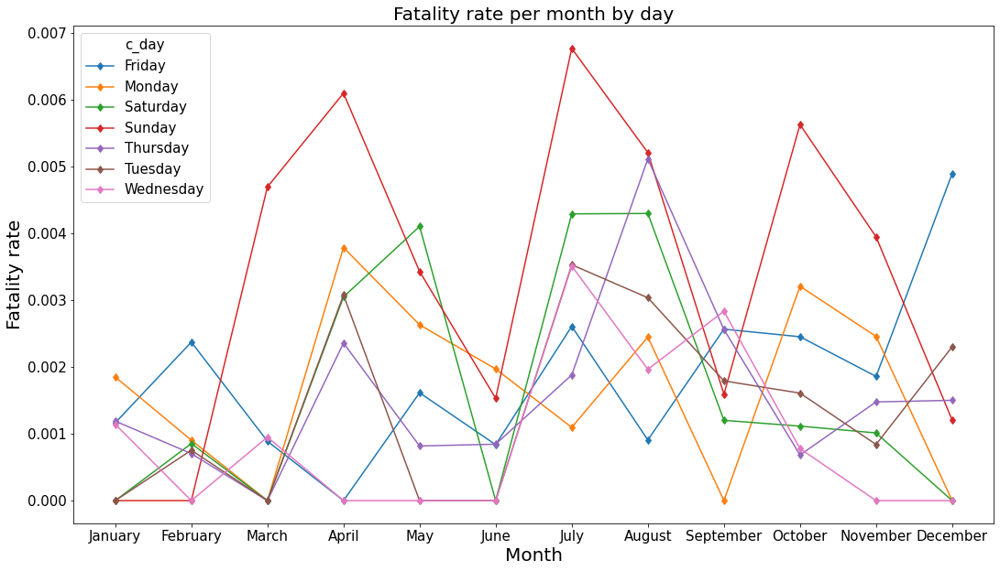

In [8]:
# Create dataframe
df_sel = df[['class', 'c_month', 'c_hour','c_day', 'c_year',
 'impact_type', 'environment', 'collision_id']]

# Replace month values with integers
month_dict = {'January':1, 'February':2, 'March':3, 'April':4,  'May':5, 'June':6, 'July':7,                    'August':8, 'September':9,'October':10, 'November':11, 'December':12}
df_sel['c_month'].replace(month_dict, inplace = True)

# Create a binary class
map_dict = {'Non-fatal injury':0, 'P.D. only':0, 'Fatal injury':1}
df_sel['class'].replace(map_dict, inplace=True)

# Pivot table
table_month1 = df_sel.pivot_table('collision_id', index = 'c_month', columns = 'c_day', aggfunc = 'count')
table_month2 = df_sel.pivot_table('class', index = 'c_month', columns = 'c_day', aggfunc = 'mean')

# Plot figure
table_month1.plot(marker = 'o',  figsize = (18,10), linewidth = 1.5)
plt.xlabel('Month', fontsize =20)
plt.ylabel('Total collision', fontsize =20)
plt.title('Total collision per month by day', fontsize =20)
plt.xticks(list(table_month1.index), list(month_dict.keys()))
plt.savefig('../image/fig1a.png')
plt.show()

plt.figure()
table_month2.plot(marker = 'd',  figsize = (18,10), linewidth = 1.5)
plt.xlabel('Month', fontsize =20)
plt.ylabel('Fatality rate', fontsize =20)
plt.title('Fatality rate per month by day', fontsize =20)
plt.xticks(list(table_month2.index), list(month_dict.keys()))
plt.savefig('../image/fig1b.png')
plt.show()

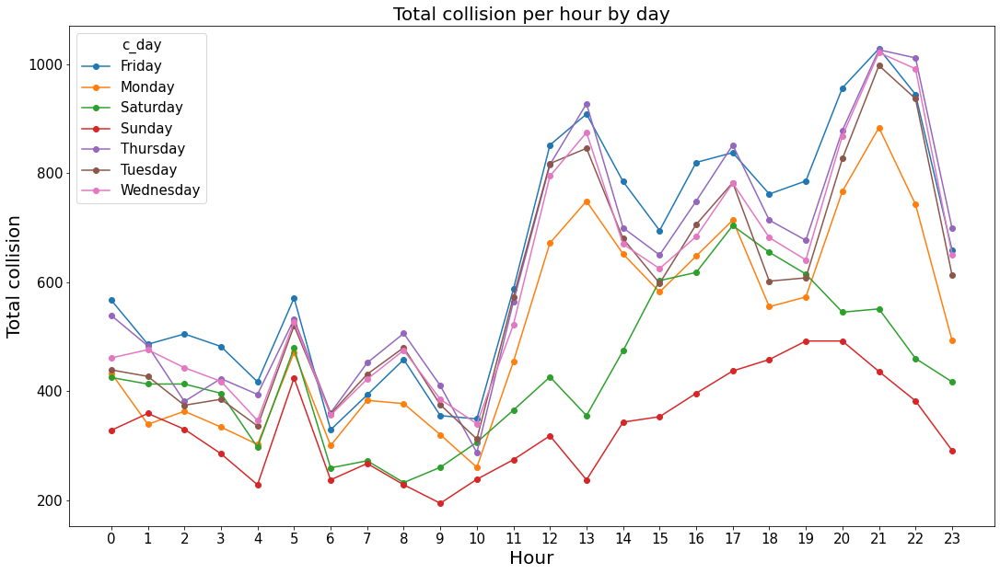

<Figure size 432x288 with 0 Axes>

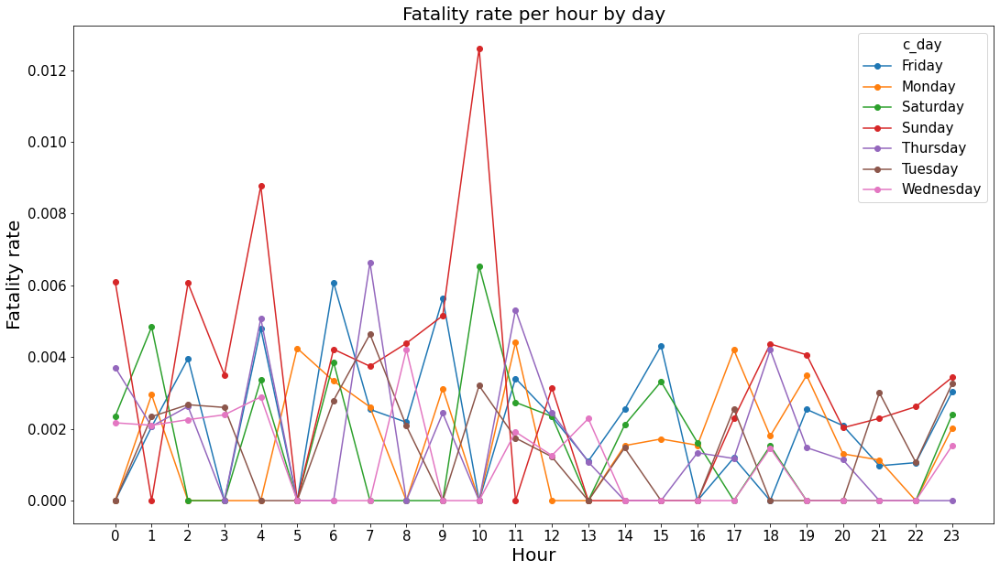

<Figure size 432x288 with 0 Axes>

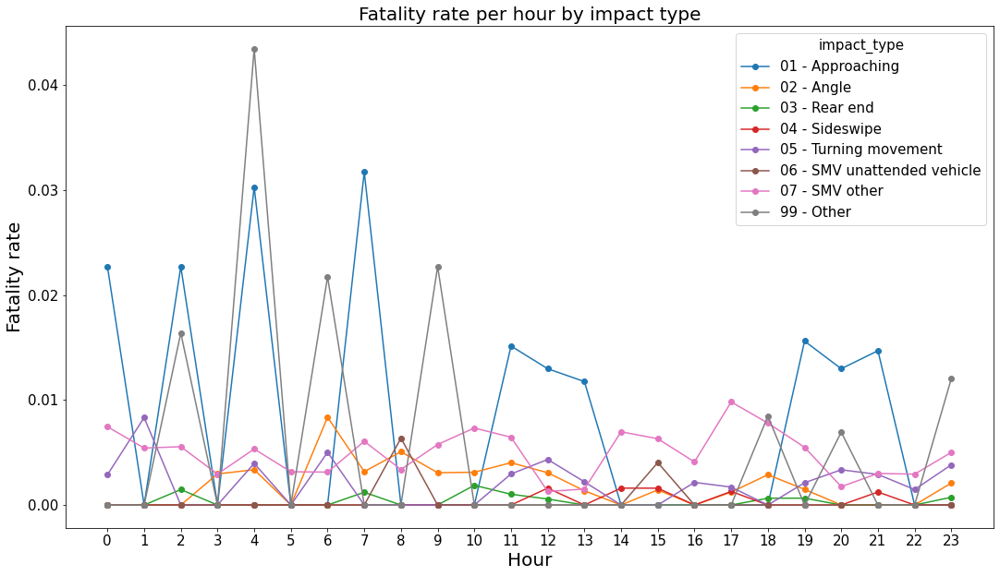

In [9]:
# Create dataframe
df_sel = df[['class', 'c_month', 'c_hour','c_day', 'c_year',
 'impact_type', 'environment', 'collision_id']]

# Create binary class
map_dict = {'Non-fatal injury':0, 'P.D. only':0, 'Fatal injury':1}
df_sel['class'].replace(map_dict, inplace=True)

pvt_hr1 = df_sel.pivot_table('class', index = 'c_hour', columns = 'c_day', aggfunc = 'mean')
pvt_hr2 = df_sel.pivot_table('class', index = 'c_hour', columns = 'impact_type', aggfunc = 'mean')
pvt_hr3 = df_sel.pivot_table('collision_id', index = 'c_hour', columns = 'c_day', aggfunc = 'count')


# Plot figure
pvt_hr3.plot(marker = 'o',  figsize = (18,10), linewidth = 1.5)
plt.xlabel('Hour', fontsize =20)
plt.ylabel('Total collision', fontsize =20)
plt.title('Total collision per hour by day', fontsize =20)
plt.xticks(list(pvt_hr3.index))
plt.savefig('../image/fig2a.png')
plt.show()

plt.figure()
pvt_hr1.plot(marker = 'o',  figsize = (18,10), linewidth = 1.5)
plt.xlabel('Hour', fontsize =20)
plt.ylabel('Fatality rate', fontsize =20)
plt.title('Fatality rate per hour by day', fontsize =20)
plt.xticks(list(pvt_hr1.index))
plt.savefig('../image/fig2b.png')
plt.show()

plt.figure()
pvt_hr2.plot(marker = 'o',  figsize = (18,10), linewidth = 1.5)
plt.xlabel('Hour', fontsize =20)
plt.ylabel('Fatality rate', fontsize =20)
plt.title('Fatality rate per hour by impact type', fontsize =20)
plt.xticks(list(pvt_hr2.index))
plt.savefig('../image/fig2c.png')
plt.show()

# Box Plots

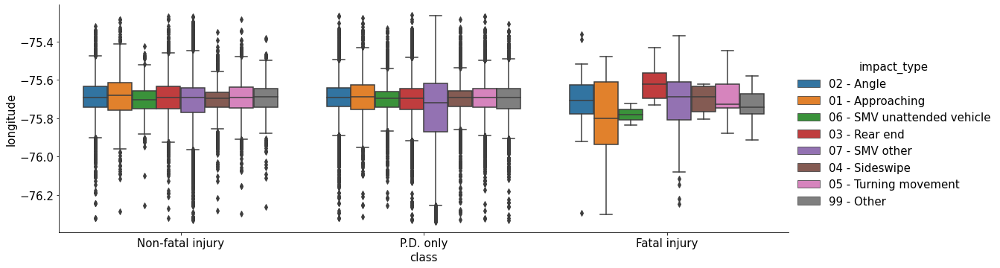

<Figure size 432x288 with 0 Axes>

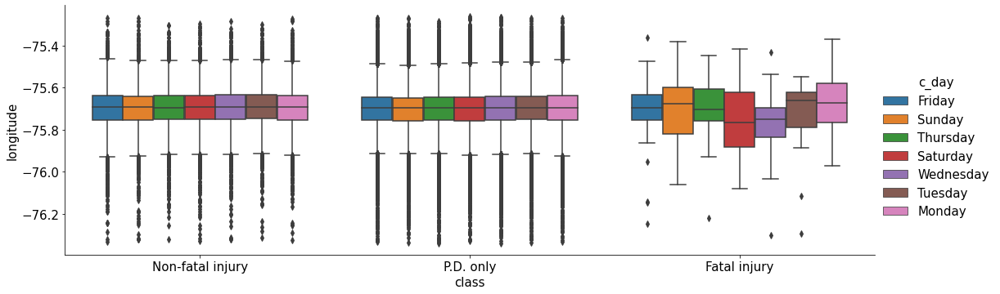

<Figure size 432x288 with 0 Axes>

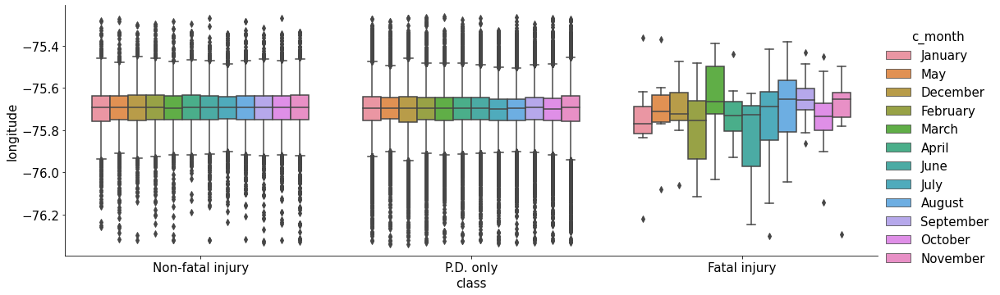

In [10]:
sns.catplot(x = 'class', y = 'longitude', data = df, kind = 'box', aspect = 3, hue = 'impact_type')

plt.figure()
sns.catplot(x = 'class', y = 'longitude', data = df, kind = 'box', aspect = 3, hue = 'c_day')

plt.figure()
sns.catplot(x = 'class', y = 'longitude', data = df, kind = 'box', aspect = 3, hue = 'c_month')